In [1]:
!python -m pip install pyyaml==5.1

!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 KB 9.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp38-cp38-linux_x86_64.whl size=44089 sha256=28251e358156fd942a715a470999b267590261b9c6760a7c48e279aafda4ad1e
  Stored in directory: /root/.cache/pip/wheels/52/dd/2b/10ff8b0ac81b93946bb5fb9e6749bae2dac246506c8774e6cf
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.2.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheel

In [2]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  1.13 ; cuda:  cu116
detectron2: 0.6


In [3]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()


import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow


from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("test", {}, "drive/MyDrive/03_cv/json_annotation_val.json", "drive/MyDrive/03_cv/testset")
register_coco_instances("train", {}, "drive/MyDrive/03_cv/json_annotation_train.json", "drive/MyDrive/03_cv/trainset")

from detectron2.structures import BoxMode

In [21]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 1000
cfg.SOLVER.STEPS = [] 
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[03/04 09:31:13 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[03/04 09:31:14 d2.engine.train_loop]: Starting training from iteration 0
[03/04 09:31:24 d2.utils.events]:  eta: 0:06:38  iter: 19  total_loss: 1.654  loss_cls: 0.9958  loss_box_reg: 0.6304  loss_rpn_cls: 0.01453  loss_rpn_loc: 0.008058  time: 0.4708  last_time: 0.3604  data_time: 0.1157  last_data_time: 0.0145   lr: 4.9953e-06  max_mem: 2946M
[03/04 09:31:34 d2.utils.events]:  eta: 0:07:15  iter: 39  total_loss: 1.666  loss_cls: 0.9422  loss_box_reg: 0.6563  loss_rpn_cls: 0.01438  loss_rpn_loc: 0.01068  time: 0.4985  last_time: 0.5737  data_time: 0.0880  last_data_time: 0.1687   lr: 9.9902e-06  max_mem: 2946M
[03/04 09:31:45 d2.utils.events]:  eta: 0:07:23  iter: 59  total_loss: 1.406  loss_cls: 0.8101  loss_box_reg: 0.5764  loss_rpn_cls: 0.01383  loss_rpn_loc: 0.008647  time: 0.5115  last_time: 0.5050  data_time: 0.0998  last_data_time: 0.0578   lr: 1.4985e-05  max_mem: 2946M
[03/04 09:31:55 d2.utils.events]:  eta: 0:07:14  iter: 79  total_loss: 1.525  loss_cls: 0.6935  loss_box_reg

In [22]:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [23]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)

[03/04 09:40:24 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [24]:
dataset_dicts = DatasetCatalog.get("test")
mc_metadata = MetadataCatalog.get("test")

[03/04 09:40:27 d2.data.datasets.coco]: Loaded 10 images in COCO format from drive/MyDrive/03_cv/json_annotation_val.json


In [25]:
import random
from detectron2.utils.visualizer import Visualizer

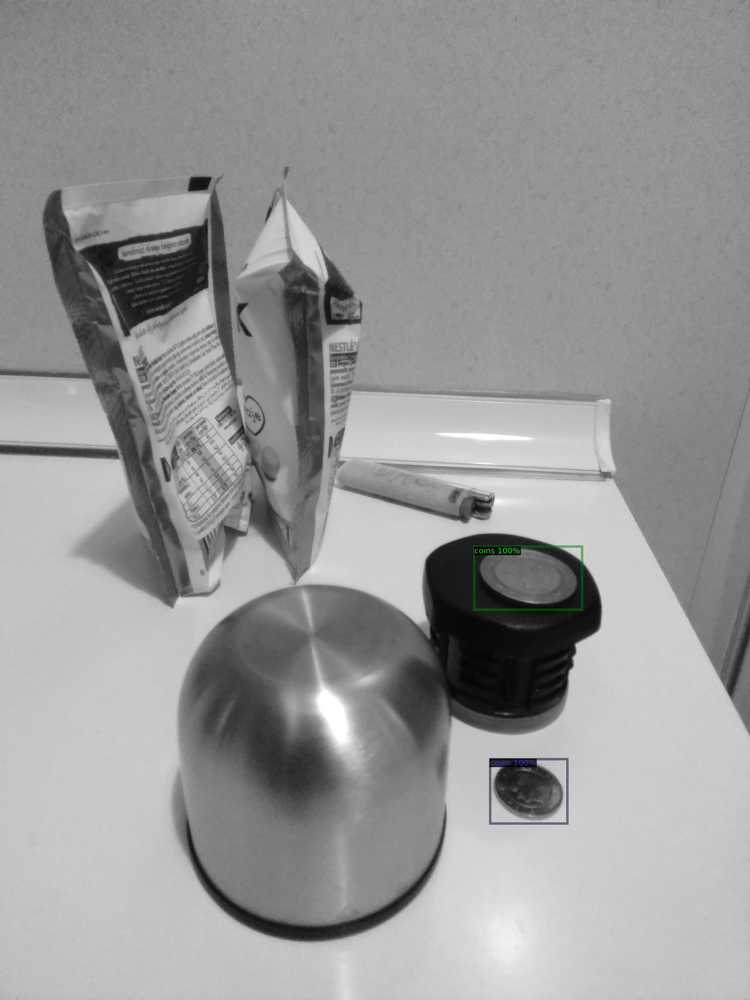

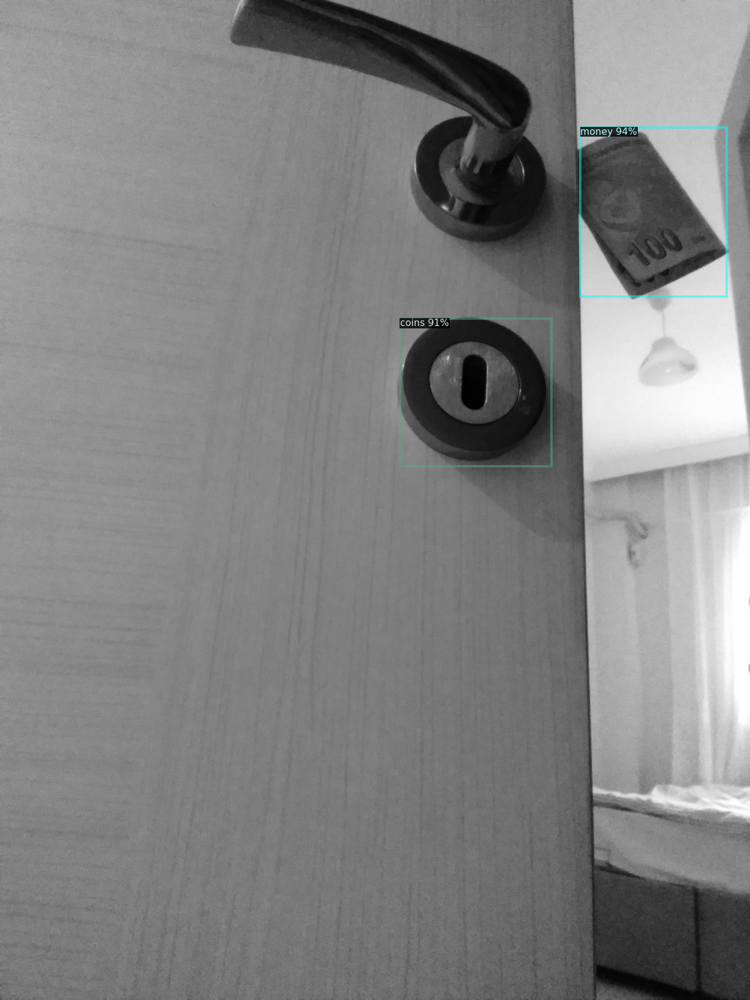

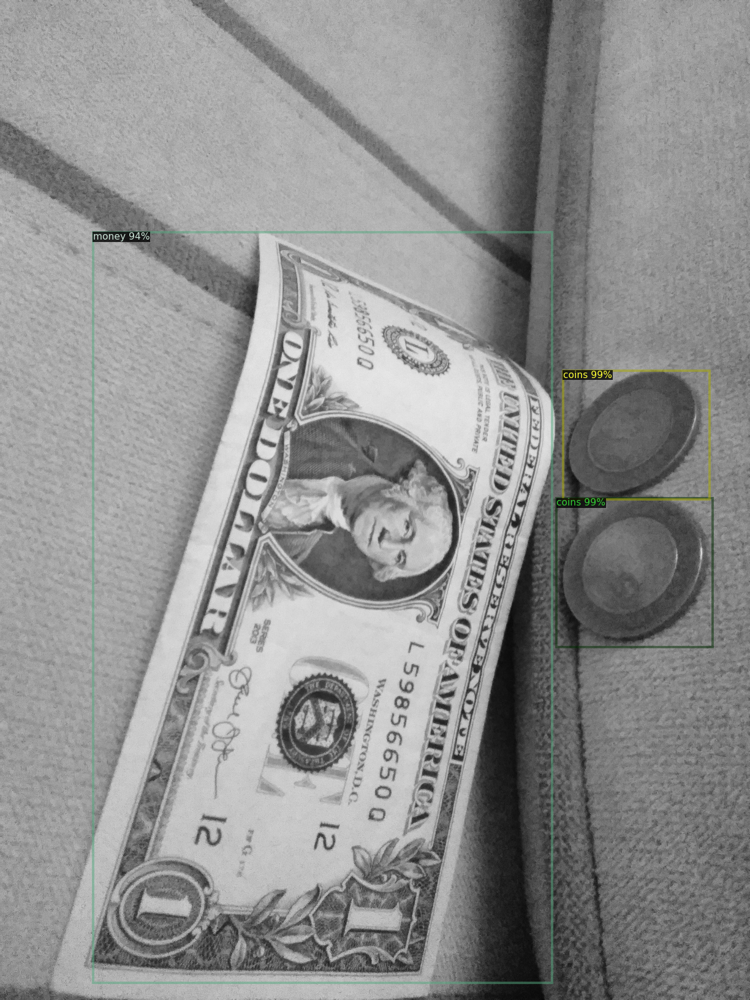

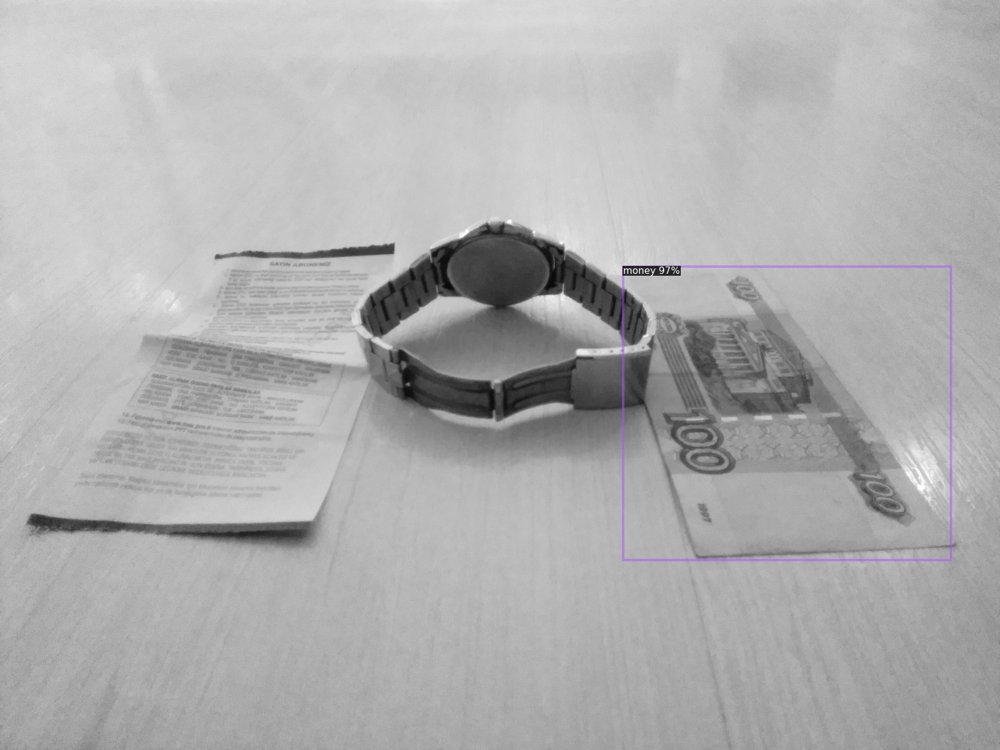

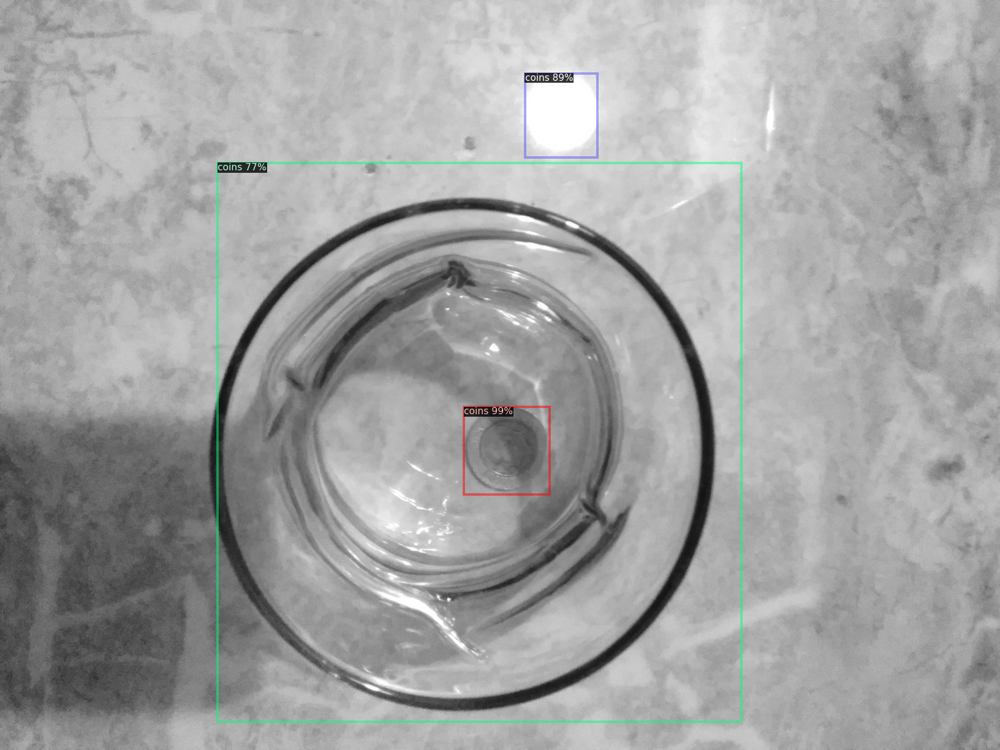

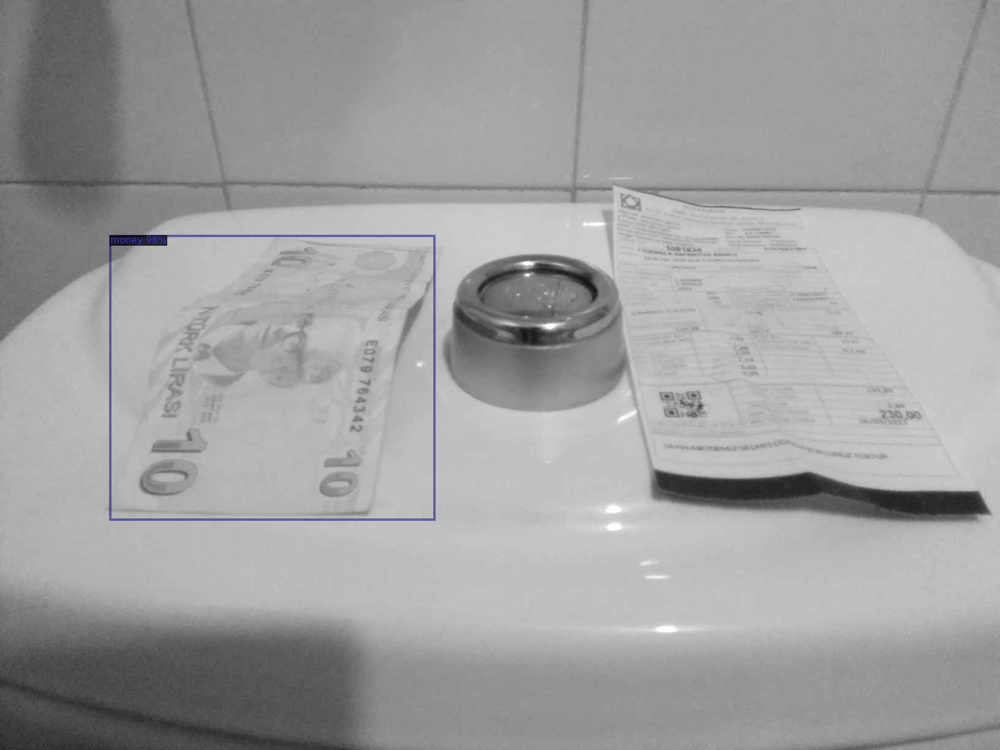

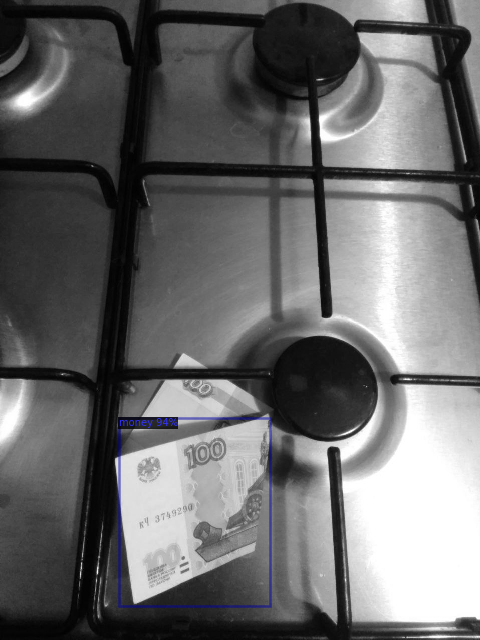

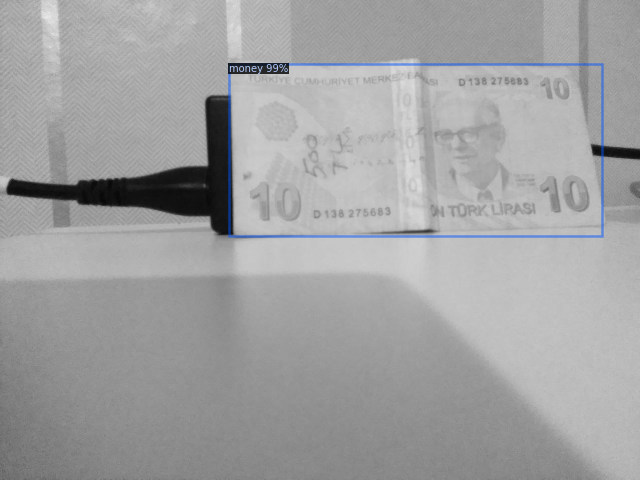

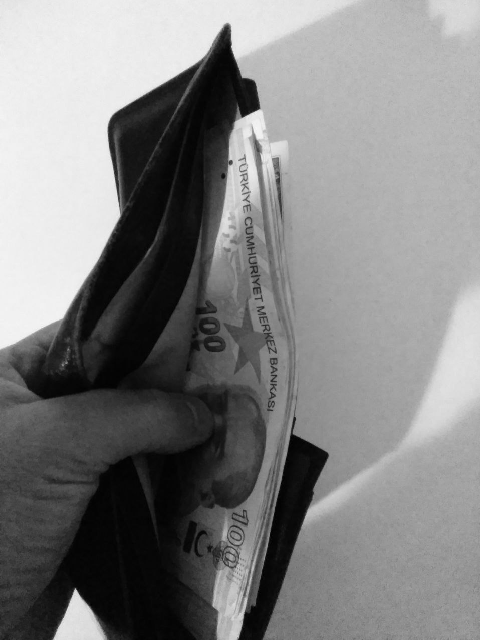

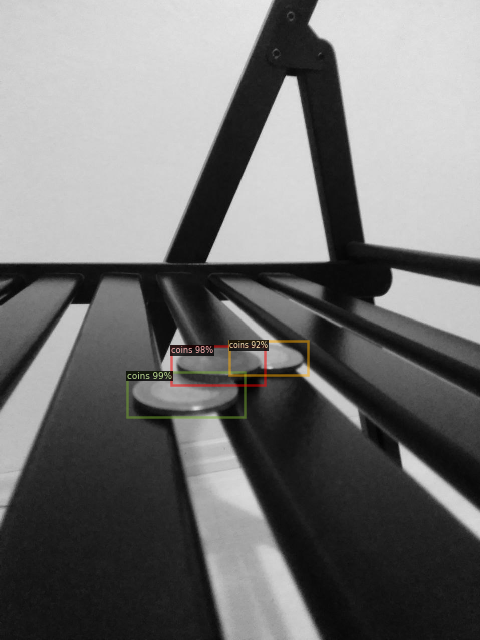

In [26]:
from detectron2.utils.visualizer import ColorMode
for d in random.sample(dataset_dicts, 10):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=mc_metadata, 
                   scale=0.5, 
                   instance_mode=ColorMode.IMAGE_BW
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [27]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("test", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "test")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

[03/04 09:40:48 d2.data.datasets.coco]: Loaded 10 images in COCO format from drive/MyDrive/03_cv/json_annotation_val.json
[03/04 09:40:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/04 09:40:48 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/04 09:40:48 d2.data.common]: Serializing 10 elements to byte tensors and concatenating them all ...
[03/04 09:40:48 d2.data.common]: Serialized dataset takes 0.00 MiB
[03/04 09:40:48 d2.evaluation.evaluator]: Start inference on 10 batches
[03/04 09:40:51 d2.evaluation.evaluator]: Total inference time: 0:00:01.433443 (0.286689 s / iter per device, on 1 devices)
[03/04 09:40:51 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.105676 s / iter per device, on 1 devices)
[03/04 09:40:51 d2.evaluation.coco_evaluation]: Preparing results for COCO format ..

In [12]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("test", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "test")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

[03/04 09:09:54 d2.data.datasets.coco]: Loaded 10 images in COCO format from drive/MyDrive/03_cv/json_annotation_val.json
[03/04 09:09:54 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|   coins    | 8            |   money    | 7            |
|            |              |            |              |
|   total    | 15           |            |              |
[03/04 09:09:54 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/04 09:09:54 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/04 09:09:54 d2.data.common]: Serializing 10 elements to byte tensors and concatenating them all ...
[03/04 09:09:54 d2.data.common]: Serialized dataset takes 0.00 MiB
[03/04 09:09:54 d2.evaluation.evaluato